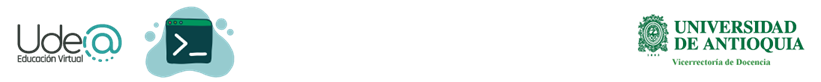


**Laboratorio Tratamiento de Señales III** *Práctica* 05

**Laboratorio: # Filtros aplicados sobre imágenes**

*   Mateo Muñoz Arroyave
CC 1036676919

*   David Esteban Londoño Patiño
CC 1020465536


**Autores:**
*   Hernán Felipe García Arias, PhD.
*   Pablo Alejandro Alvarado Duran, PhD.



**Facultad de Ingeniería**

**Universidad de Antioquia**

---

- Este cuaderno muestra elementos fundamentales del **filtrado de imágenes**, y utiliza principalmente funciones del toolbox ``scikit-image`` ([documentación](https://scikit-image.org/)).

## Importar módulos de scikit-image

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import skimage
import skimage.color as skic # operaciones con color
import skimage.filters as skif # filtros
import skimage.data as skid # bases de datos (archivos de imágenes)
import skimage.util as sku # utilidades
import cv2
from skimage import io, img_as_ubyte, util
from skimage import filters

%matplotlib inline

## Cargar y visualizar datos (imágenes)

In [ ]:
# vamos a definir algunas funciones para mostrar resultados

def show(img):
    fig, ax = plt.subplots(1, 1, figsize=(5, 5))
    ax.imshow(img, cmap=plt.cm.gray) # usar pyplot biultin colormap gray
    ax.set_axis_off()
    plt.show()

def showPair(img,filt_img):
    fig, ax = plt.subplots(1, 2, figsize=(10, 10))
    ax[0].imshow(img, cmap=plt.cm.gray)
    ax[0].set_axis_off()
    ax[1].imshow(filt_img, cmap=plt.cm.gray)
    ax[1].set_axis_off()
    plt.show()

Vamos a cargar una imagen de ejemplo de la base de datos de Scikit-image [(skimage dataset)](https://scikit-image.org/docs/stable/api/skimage.data.html), para luego aplicar diferentes filtros espaciales a esta imagen.

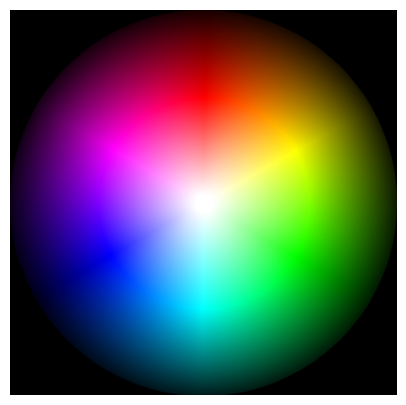

In [ ]:
img =skid.colorwheel() # alterar color imagen
show(img)

## Filtros
En términos generales un filtro espacial corresponde a calcular la convolución entre un segmento (ventana) de los datos y una función preestablecida conocida como kernel


$$ \text{Imagen filtrada} = \text{Imagen original } \ast \text{ kernel}$$


La expresión anterior se puede definir matemáticamente como

$$g(x,y) = k \ast f(x,y) = \sum_{d_x =-a}^{a}\sum_{d_y =-b}^{b} k(d_x, d_y) \cdot f(x-d_x,y-d_y)$$

### Filtrado espacial

Definición en 2D de la convolución


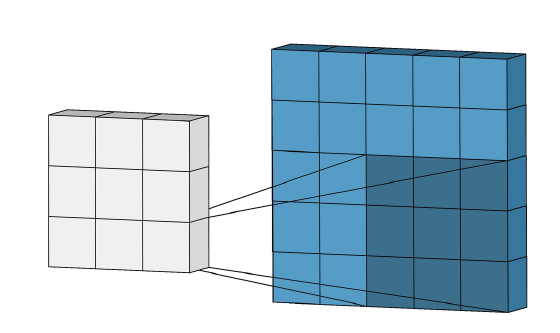

Ver [video](https://www.youtube.com/watch?v=KuXjwB4LzSA) sobre convolución en filtrado de imágenes.

La convolución se define para imágenes infinitamente grandes.

**Problema**
* Las imágenes son un arreglo finito de elementos, es decir, tienen límites o fronteras. El kernel no tiene soporte sobre los límites de los datos (imagen).


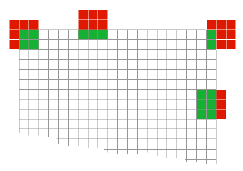

Hay diferentes maneras de solucionar este inconveniente:
- ignorar límites
- usar reflejo
- asumir valores constantes
- entre otras


### Filtro Gaussiano

[Gauss filter usage](https://scikit-image.org/docs/dev/api/skimage.filters.html#skimage.filters.gaussian)

/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:348: RuntimeWarning: Images with dimensions (M, N, 3) are interpreted as 2D+RGB by default. Use `multichannel=False` to interpret as 3D image with last dimension of length 3.
  return func(*args, **kwargs)


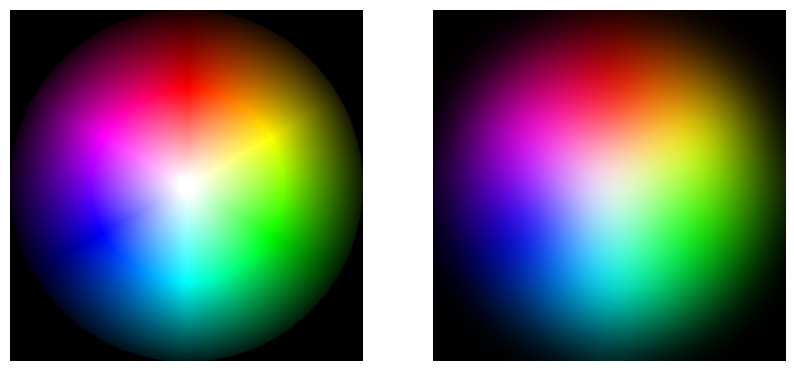

In [ ]:
import matplotlib.pyplot as plt
imgLP_Gauss = skif.gaussian(img, 20)
showPair(img,imgLP_Gauss)

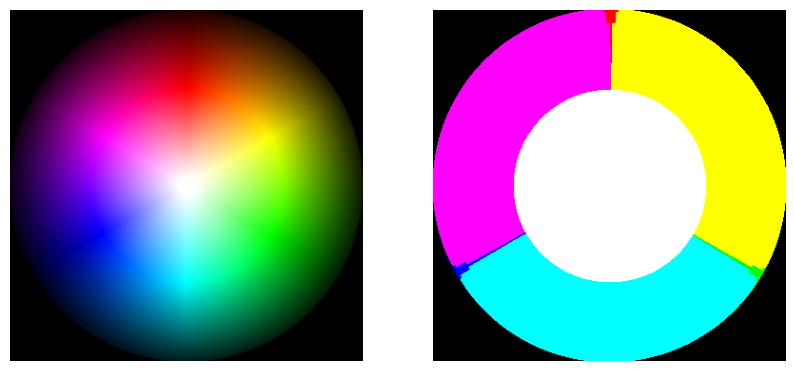

In [ ]:
imgHP_AfterSmoothing = img - imgLP_Gauss
showPair(img,imgHP_AfterSmoothing)

Las figuras anteriores muestran los resultados experimentales obtenidos. Se puede concluir que el kernel Gaussiano actúa como un filtro pasa-baja, produciendo imégenes más suaves.

Si restamos la imagen suavizada con la original obtendremos una imagen con sus respectivos bordes resaltados.


### Filtro Sobel

[Sobel filter usage](https://scikit-image.org/docs/dev/api/skimage.filters.html#skimage.filters.sobel)

Este filtro aproxima el gradiente de la imagen (su derivada), por lo tanto, regiones con cambios abruptos serán resaltadas (bordes).

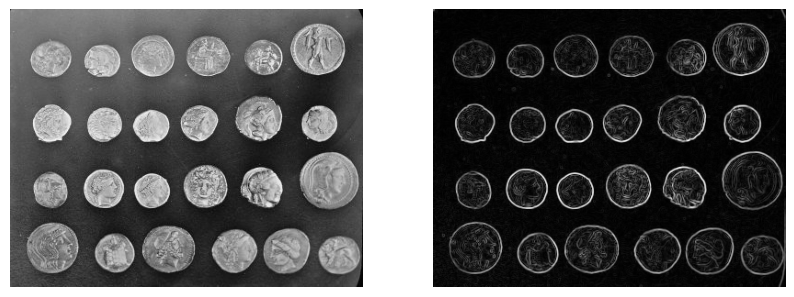

In [ ]:
img = skimage.img_as_float(skid.coins())
sobimg = skif.sobel(img)
showPair(img,sobimg)

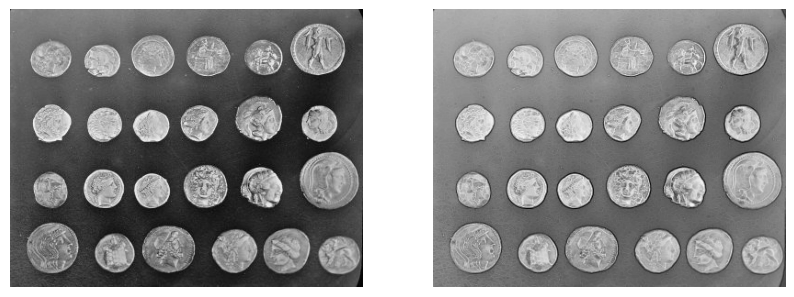

In [ ]:
imgHP_AfterSmoothing = img - sobimg
showPair(img, imgHP_AfterSmoothing)

### Filtros pasa-alta

- Los filtros pasa altas resaltan los cambios abruptos de intensidad entre valores/datos adyacentes en la imagen. Esto se conoce como bordes (edges en inglés).

- A continuación, vamos a umbralizar el resultado de aplicar el filtro sobel, para conservar cierta cantidad de bordes.

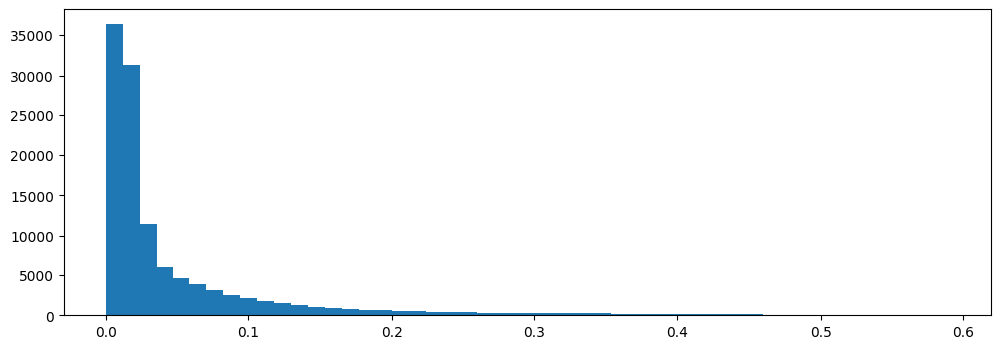

In [ ]:
plt.figure(figsize=(12, 4))
plt.hist(sobimg.reshape(-1,1), bins=50);

In [ ]:
from ipywidgets import widgets

@widgets.interact(x=(0.0001, .5, .005))
def edge(x):
    show(sobimg < x)

interactive(children=(FloatSlider(value=0.24509999999999998, description='x', max=0.5, min=0.0001, step=0.005)…

## Reducción de ruido

Vamos a corromper los datos de la imagen con ruido Gaussiano $\mathcal{N}(0,\sigma^2)$



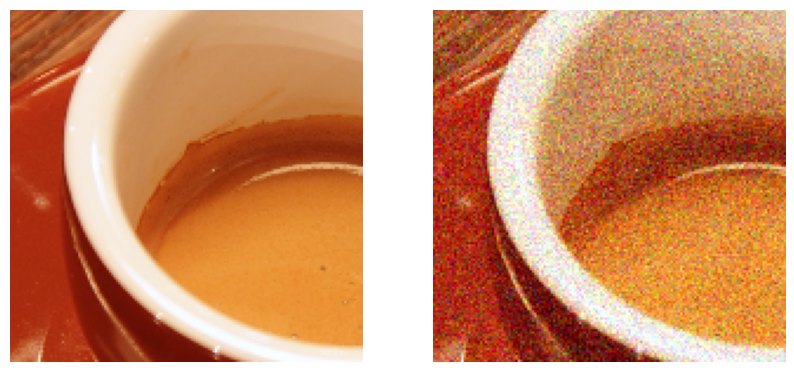

In [ ]:
img2 = skimage.img_as_float(skid.coffee())

# usar un semento de la imagen total.
img2 = img2[50:200, 150:300]

# adicionar ruido Gaussiano.
img_n = sku.random_noise(img2)
showPair(img2, img_n)

In [ ]:
img3 = skid.colorwheel()
print(f"valor máximo {img3.max()}, valor mínimo: {img3.min()}")

img2_float = skimage.img_as_float(img3)
print(f"valor máximo {img2_float.max()}, valor mínimo: {img2_float.min()}")


valor máximo 255, valor mínimo: 0
valor máximo 1.0, valor mínimo: 0.0


### Restauración de imágenes


El toolbox Scikit-image tiene diferentes enfoques para la restauración de imágenes ([image restoration](https://scikit-image.org/docs/dev/api/skimage.restoration.html) ).

A continuación exploramos el filtro [split-Bregman optimization.](https://scikit-image.org/docs/dev/api/skimage.restoration.html#skimage.restoration.denoise_tv_bregman)

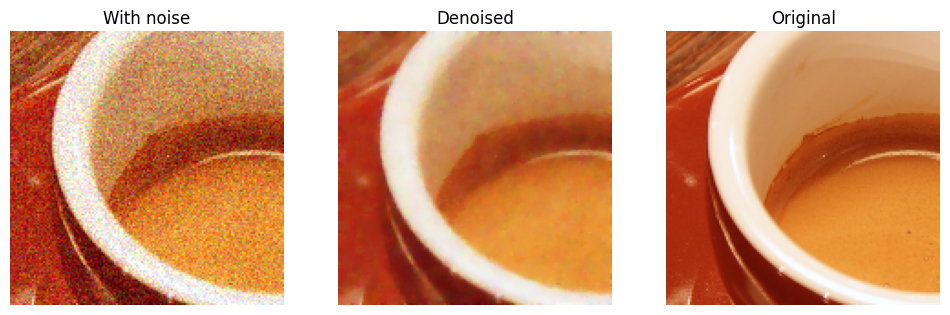

In [ ]:
img_r = skimage.restoration.denoise_tv_bregman(
    img_n, 5.)

fig, (ax1, ax2, ax3) = plt.subplots(
    1, 3, figsize=(12, 8))

ax1.imshow(img_n)
ax1.set_title('With noise')
ax1.set_axis_off()

ax2.imshow(img_r)
ax2.set_title('Denoised')
ax2.set_axis_off()

ax3.imshow(img2)
ax3.set_title('Original')
ax3.set_axis_off()

## Desarrollo Práctica de Laboratorio

El ruido es un factor importante que dificulta el análisis de las señales. Por lo tanto, muchas aplicaciones de tratamiento de señales requieren de una etapa preliminar que limpie los datos(filtrado), y que además realce determinadas propiedades de las señales, como por ejemplo hacer más evidentes los bordes de una imagen.

Existen diferentes tipos de ruido dependiendo de la naturaleza de las señales obtenidas por medio de sensores, como por ejemplo un micrófono o la lente de una cámara fotográfica. Con el propósito de entender cómo diferentes tipos y niveles de ruido afectan las señales multivariadas, vamos a escoger 3 imágenes de interés en escala de grises y a color(pueden ser de aplicaciones en diferentes campos de las ciencias). Luego, vamos a contaminar cada imagen con diferentes tipos y niveles de ruido, específicamente utilizaremos estos cuatro tipos de ruido:

- Gaussiano.
- Poisson.
- Sal y Pimienta.
- Acustico.

El primer paso a realizar será la carga de las imagenes como recursos desde Internet.

In [ ]:
!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1OtbedRyT9MezMwil5_ZOSWtoq8kvYXih' -O 'The-walking-dead.jpg';
!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1nqKmfNx10lNRUQmawbAHD1RW_K3GmwSF' -O 'Escudo_de_Atlético_Nacional.png';
!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1hKHiwia6ghezrVw7dPpLmdeKrfqWn5t8' -O 'Cebras.jpg';

--2023-09-19 03:17:33--  https://drive.google.com/uc?export=download&id=1OtbedRyT9MezMwil5_ZOSWtoq8kvYXih
Resolving drive.google.com (drive.google.com)... 172.253.119.101, 172.253.119.113, 172.253.119.139, ...
Connecting to drive.google.com (drive.google.com)|172.253.119.101|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-08-ac-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/ilg5qdc8oeio6ams0hefdtmmimn7u0m3/1695093450000/15202217475084859734/*/1OtbedRyT9MezMwil5_ZOSWtoq8kvYXih?e=download&uuid=6a977618-5715-40f9-b89b-3c04a0a97bd3 [following]
--2023-09-19 03:17:33--  https://doc-08-ac-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/ilg5qdc8oeio6ams0hefdtmmimn7u0m3/1695093450000/15202217475084859734/*/1OtbedRyT9MezMwil5_ZOSWtoq8kvYXih?e=download&uuid=6a977618-5715-40f9-b89b-3c04a0a97bd3
Resolving doc-08-ac-docs.googleusercontent.com (doc-08-ac-docs.googleusercontent.com)... 173.194.197.132, 

Ahora procedemos a cargar las iamgenes al espacio de trabajo. Para el desarrollo de la práctica se cargará una imagen a color, una imagen con colores vivos y con detalles muy sencillos, muy lineales, como lo es el escudo de uno de los equipos de futbol del país y finalmente una imagen a blanco y negro.

In [ ]:
img1 = io.imread('The-walking-dead.jpg')
img2 = io.imread('Escudo_de_Atlético_Nacional.png')
img3 = io.imread('Cebras.jpg')

Estos tipos de ruido están implementados en la librería SKIMAGE. Interprete los resultados y analice qué tipo de efecto tiene cada ruido sobre las imágenes.

Para tal cometido se realiza una función de Python que se encargará de aplicar los tipos de filtro y graficarlos para poder observar su comportamiento.

In [ ]:
#Funcion para agregar ruido y graficar

def muestra_imag(img1):
  img1_g  = sku.random_noise(img1, var=0.2)
  img1_p  = sku.random_noise(img1, mode='poisson')
  img1_sp = sku.random_noise(img1, mode='s&p', amount = 0.2)
  img1_ac = sku.random_noise(img1, mode='speckle', var = 0.5)


  fig, axs = plt.subplots(2, 3, figsize=(20, 15))

  axs[0,0].imshow(img1)
  axs[0,0].set_title('Original')
  axs[0,0].set_axis_off()

  axs[0,1].imshow(img1_g)
  axs[0,1].set_title('Gaussiano')
  axs[0,1].set_axis_off()

  axs[0,2].imshow(img1_p)
  axs[0,2].set_title('Poisson')
  axs[0,2].set_axis_off()

  axs[1,0].imshow(img1)
  axs[1,0].set_title('Original')
  axs[1,0].set_axis_off()

  axs[1,1].imshow(img1_sp)
  axs[1,1].set_title('Sal y Pimienta')
  axs[1,1].set_axis_off()

  axs[1,2].imshow(img1_ac)
  axs[1,2].set_title('Acustico')
  axs[1,2].set_axis_off()



  plt.tight_layout()
  plt.show()

  return img1_g, img1_p, img1_sp, img1_ac

Se procede entonces a observar las imagenes originales cargadas inicialmente al espacio de trabajo bajo la influencia de los cuatro tipos de filtro definidos anteriormente en esta guía práctica.

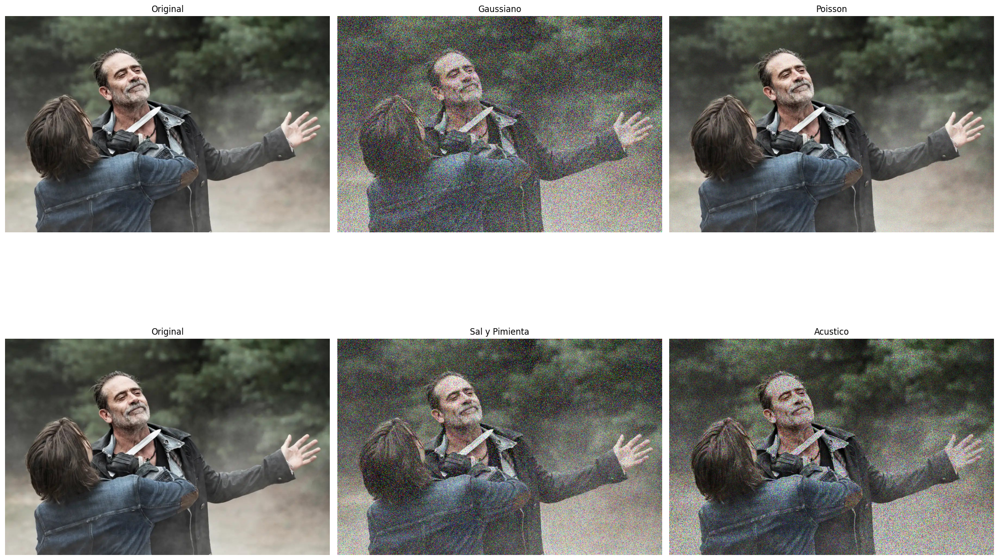

In [ ]:
#Imagen 1
img1_g,  img1_p, img1_sp, img1_ac = muestra_imag(img1)


En esta primera imagen es posible apreciar que el filtro de Poisson fue el filtro que a simple vista menos contaminó la imagen, es posible apreciar que los tres otros tipos de ruidos han obtenido resultados mucho más significativos, siendo estos, el filtro acustico el que se aprecia una mayor cantidad de distorsión en la imagen, observandose en la expresión facial del personaje como se pierden ciertos detalles, incluso ciertas tonalidades de colores.

Por su parte el ruido Gaussiano también presenta una gran cantidad de ruido en forma de lluvia.

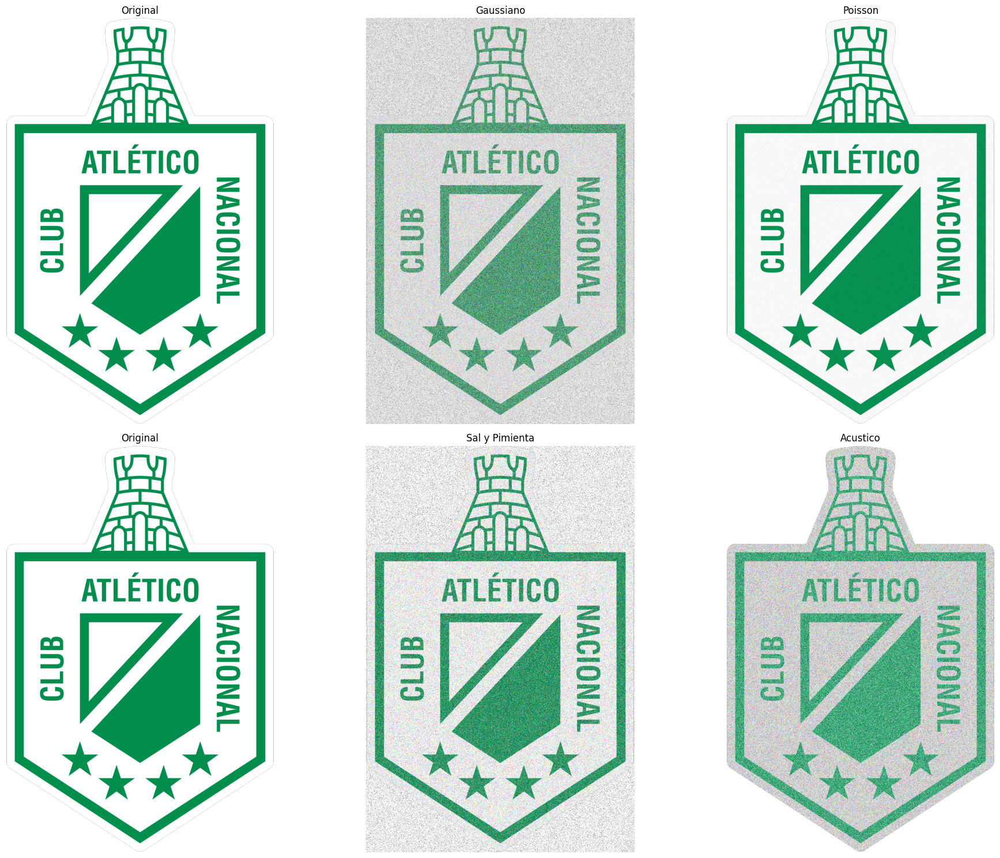

In [ ]:
# Imagen 2

img2_g,  img2_p, img2_sp, img2_ac = muestra_imag(img2)

En esta segunda imagen es posible apreciar nuevamente como el filtro de Poisson es el filtro que menos afectó la imagen original, además como el filtro acustico no afectó la zona blanca externa de la imagen, afectando claramente su entorno conviertiendo las zonas blancas de la zona de la imagen que hacer parte del escudo en una imagen con efecto de lluvia, además logrando cambios en la tonalidad del color verde predominante en la imagen principal.

Igualmente para los filtros de Sal y Pimienta y Gaussiano, nuevamente fueron los filtros que más afectaron la imagen, logrando igualmente en el filtro gaussiano cambios en la tonalidad del color verde.

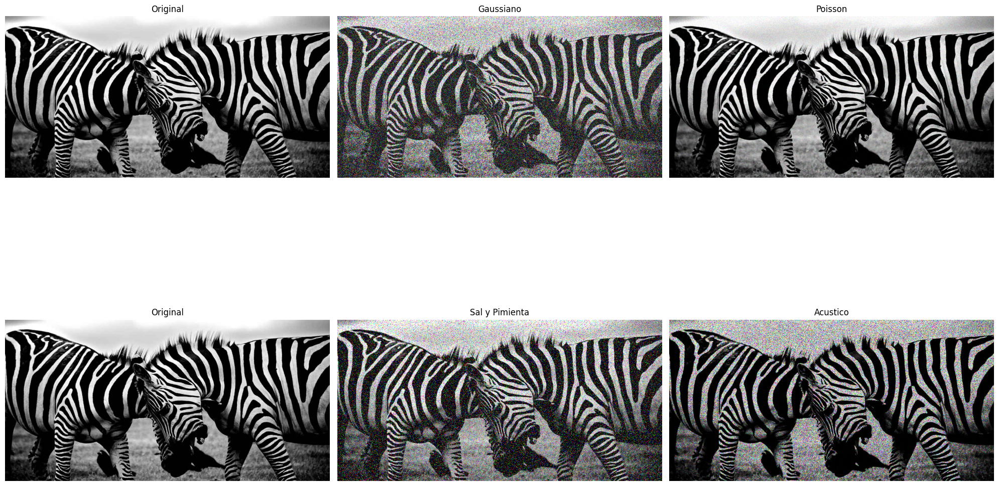

In [ ]:
# Imagen 3

img3_g,  img3_p, img3_sp, img3_ac = muestra_imag(img3)

Finalmente se tiene la imagen a blanco y negro, y en escala de grises, esta imagen repite el patron de las anteriores imagenes, con el filtro de Poisson siendo el filtro que menos afecta la calidad de la imagen, y con el filtro Gaussiano logrando modificar las tonalidades de los colores que está afectando.

Finalmente tras examinar todos los tipos de imagenes a su paso por los diferentes tipos de filtros se puede concluir lo siguiente respecto a cada tipo de filtro:

**Para el ruido gaussiano:**
La imagen se verá afectada por un ruido aditivo que se distribuye de manera normal, lo que resultará en un aspecto "borroso" perdiendo ciertos detalles finos. Además, los colores de la imagen pueden parecer más apagados y menos saturados debido a la adición de valores de píxeles aleatorios. Se puede observar que el ruido gaussiano generalmente afecta a todos los canales de color (rojo, verde y azul) de manera similar.

**Para el ruido Poisson:**
Los colores de la imagen pueden parecer con una pequeña perdida de saturación, si de presta cierto detalle se puede apreciar una cierta cantidad de ruido granular.

**Para el ruido sal y pimienta:**
Se puede apreciar la aparición de pixeles blancos (sal) y negros (pimientas) distirbuidos aleatoriamente en la imagen en forma de manchas o puntos que contaminan la imagen.

**Para el ruido acustico:**
Aparecer como distorsiones en los colores y patrones de la imagen. Generando cambios en las tonalidades y saturación de los colores, siendo este el tipo de ruido que más afectó las imagenes.

#Filtrado de imagenes

Utilice las siguientes estrategias de filtrado para las cuales se requiere que varíe losparámetros propios de cada método (filtro) y evalúe la relación señal a ruido (SNR). Las estrategias de filtrado a utilizar son:

#### Filtro Gaussiano, Filtro de Mediana y Filtro Butterworth

Inicialmente se define una función para ahorrar código a la hora de graficar los diferentes resultados obtenidos.

In [ ]:
def graficarTodas(img1,img1Titulo,img2,img2Titulo,img3,img3Titulo,img4,img4Titulo,img5,img5Titulo):
    fig, axs = plt.subplots(1, 5, figsize=(20, 15))

    axs[0].imshow(img1)
    axs[0].set_title(img1Titulo)
    axs[0].set_axis_off()

    axs[1].imshow(img2)
    axs[1].set_title(img2Titulo)
    axs[1].set_axis_off()

    axs[2].imshow(img3)
    axs[2].set_title(img3Titulo)
    axs[2].set_axis_off()

    axs[3].imshow(img4)
    axs[3].set_title(img4Titulo)
    axs[3].set_axis_off()

    axs[4].imshow(img5)
    axs[4].set_title(img5Titulo)
    axs[4].set_axis_off()

    plt.tight_layout()
    plt.show()

Y se define una función con la cual se aplicarán los tres tipos de filtros propuestos, filtro Gaussiano, Filtro de Mediana y filtro Butterworth.

In [ ]:
def Filtros(img, img1_g):
  img_grg = filters.gaussian(img1_g, sigma=1.0)
  img_grm = filters.median(img1_g, selem=None, mode='nearest', cval=0.8)
  img_grb = filters.butterworth(img1_g, cutoff_frequency_ratio=0.45, high_pass=False, order=8.0, channel_axis=None)

  graficarTodas(img,'Original',
                img1_g,'Imagen con ruido',
                img_grm,'Filtro mediana',
                img_grb,'Filtro Butterworth',
                img_grg,'Filtro Gaussiano')

  return img_grm, img_grb, img_grg

Compare las imágenes restauradas (obtenidas) con las originales (sin ruido), qué filtros y qué valores de sus parámetros producen reconstrucciones más precisas?

### Filtro imagen 1 con ruido Gaussiano

<ipython-input-76-e4bd6d217e84>:3: FutureWarning: `selem` is a deprecated argument name for `median`. It will be removed in version 1.0. Please use `footprint` instead.
  img_grm = filters.median(img1_g, selem=None, mode='nearest', cval=0.8)


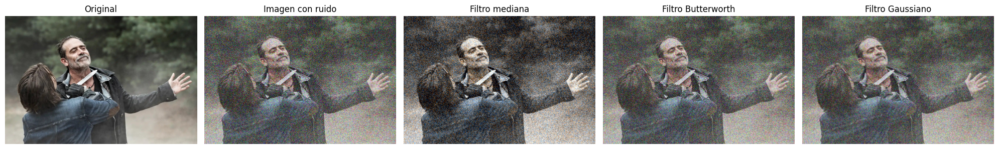

In [ ]:
img1_grm, img1_grb, img1_grg = Filtros(img1, img1_g)

Al usar los filtros para reconstruir la imagen afectada por ruido gaussiano, es posible apreciar como ei filtro mediana resultó en un cambio significativo de las tonalidades de los colores de la piel y los arboles haciendo que estos pierdan saturación en gran medida aunque preservando los bordes de la imagen, el filtro gaussiano permite apreciar un suaviazado en los bordes de la imagen reduciendo así el ruido de alta frecuencia, pero también disminuyendo la nitidez de la imagen y el filtro Butterworth no permitió a simple vista corrección alguna atenuando el ruido gaussiano al reducir las frecuencias de alta y baja intensidad en la imagen, pero suavizando los bordes y detalles finos.

### Filtro imagen 2 con ruido acustico



<ipython-input-76-e4bd6d217e84>:3: FutureWarning: `selem` is a deprecated argument name for `median`. It will be removed in version 1.0. Please use `footprint` instead.
  img_grm = filters.median(img1_g, selem=None, mode='nearest', cval=0.8)


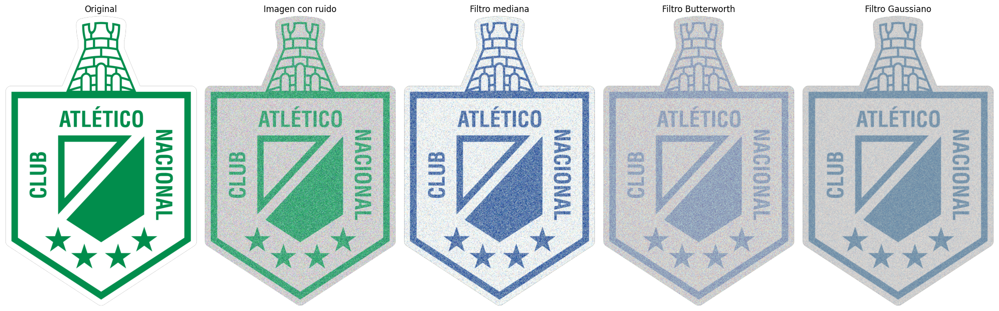

In [ ]:
img2_grm, img2_grb, img2_grg = Filtros(img2,img2_ac)

El denominador común en el filtrado de esta imagen afectada por ruido acustico, es observar como se cambió la tonalidad del color completamente, logrando tonos azules muy marcados, en especial, para el filtro de mediana, tonos muy opacos y grisaceos en el filtro butterwoth, añadiendo más componentes de ruido a la imagen, siendo demostrado como poco eficaz contra este tipo de ruido.

El filtro de mediana puede ayudar a reducir el ruido acústico de las zonas blancas al reemplazar cada píxel por el valor de mediana en su vecindario, lo que tiende a eliminar los valores extremos causados por el ruido.

El filtro Gaussiano tuvo un efecto al suavizar la imagen, logrando que la imagen pierda detalles importantes, demostrando ser poco efectivo para eliminar este tipo de ruido, especialmente si es periódico o tiene patrones específicos.

### Filtro imagen 3 con ruido sal y pimienta

<ipython-input-76-e4bd6d217e84>:3: FutureWarning: `selem` is a deprecated argument name for `median`. It will be removed in version 1.0. Please use `footprint` instead.
  img_grm = filters.median(img1_g, selem=None, mode='nearest', cval=0.8)


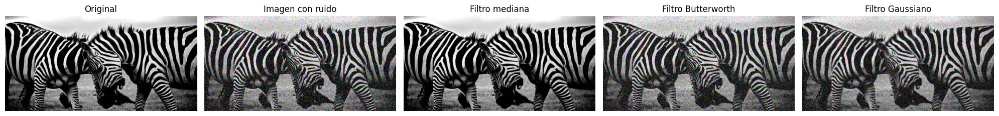

In [ ]:
img3_grm, img3_grb, img3_grg = Filtros(img3,img3_sp)

Finalmente, en la imagen a blanco y negro, afectada por el ruido sal y pimienta, es posible apreciar que el filtro de mediana es altamente efectivo para eliminar el ruido sal y pimienta en una imagen en blanco y negro, ya que reemplaza los píxeles ruidosos por el valor de mediana en su vecindario, preservando así los detalles de la imagen mientras elimina los píxeles de ruido, no siendo así el caso de los demás filtros donde no se puede apreciar el nivel de corrección logrado por el filtro de mediana.

El filtro Butterworth no es la elección ideal para el ruido sal y pimienta en una imagen en blanco y negro, ya que está diseñado para atenuar las frecuencias y no aborda directamente la eliminación de valores extremos.

El filtro Gaussiano no es eficaz para eliminar el ruido sal y pimienta, ya que tiende a suavizar la imagen y puede incluso dispersar los píxeles de ruido, pero no eliminarlos por completo. Es preferible utilizar el filtro de mediana en este caso.

#Bordes de las imagenes

Extraiga los bordes de las imágenes originales, con ruido, y reconstruidas. ¿Cómo afecta el ruido a los bordes de estas imágenes? argumente.

In [ ]:
def extraerBordes(img1):
  img1_bordes = skimage.img_as_float(img1)
  sobimg1 = skif.sobel(img1_bordes)
  img1HP_AfterSmoothing = img1 - sobimg1

  return sobimg1, img1HP_AfterSmoothing

### Extracción de Bordes imagen 1 con ruido Gaussiano

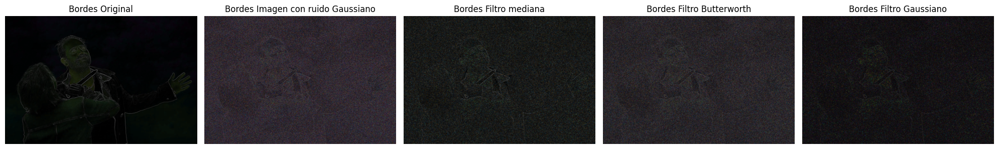

In [ ]:
img1_sob,     img1HP_AfterSmoothing     = extraerBordes(img1)
img1_g_sob,   img1_gHP_AfterSmoothing   = extraerBordes(img1_g)
img1_grm_sob, img1_grmHP_AfterSmoothing = extraerBordes(img1_grm)
img1_grb_sob, img1_grbHP_AfterSmoothing = extraerBordes(img1_grb)
img1_grg_sob, img1_grgHP_AfterSmoothing = extraerBordes(img1_grg)

graficarTodas(img1_sob,'Bordes Original',
              img1_g_sob,'Bordes Imagen con ruido Gaussiano',
              img1_grm_sob,'Bordes Filtro mediana',
              img1_grb_sob,'Bordes Filtro Butterworth',
              img1_grg_sob,'Bordes Filtro Gaussiano')

Tras un análisis de los bordes de la imagen original, aquella afectada con Ruido Gaussiano y la reconstrucción de esta con los tres filtros propuestos es posible observar como el ruido afectó de manera considerable los bordes de la imagen, con los promedios en el vecindario que realiza por su naturaleza logra un efecto de suavizado en la imagen que se puede apreciar al extraer los bordes.

Es posible apreciar que el filtro mediana es aquel que logra mejores resultados en la reconstrucción de la imagen de cara a sus bordes, pero se ha visto en las imagenes anteriores los cambios en la saturación de los colores, se aprecia suavizado en su salida, al igual que el filtro gaussiano, aquel que presenta mayor suavizado.

### Extracción de Bordes imagen 2 con ruido acustico

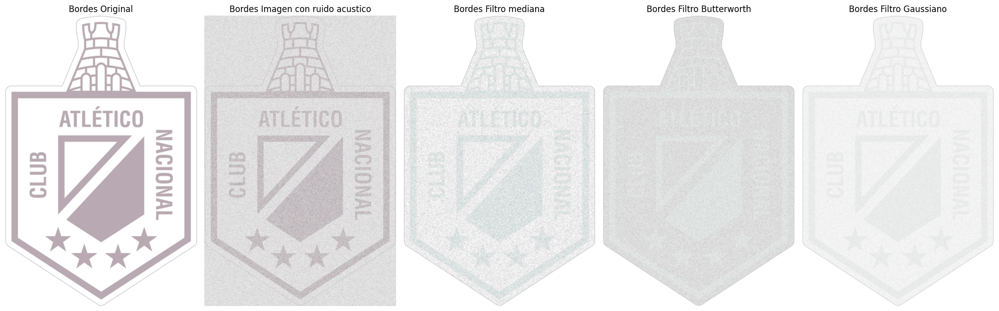

In [ ]:
img2_sob,     img2HP_AfterSmoothing     = extraerBordes(img2)
img2_g_sob,   img2_gHP_AfterSmoothing   = extraerBordes(img2_g)
img2_grm_sob, img2_grmHP_AfterSmoothing = extraerBordes(img2_grm)
img2_grb_sob, img2_grbHP_AfterSmoothing = extraerBordes(img2_grb)
img2_grg_sob, img2_grgHP_AfterSmoothing = extraerBordes(img2_grg)

graficarTodas(img2_sob,'Bordes Original',
              img2_g_sob,'Bordes Imagen con ruido acustico',
              img2_grm_sob,'Bordes Filtro mediana',
              img2_grb_sob,'Bordes Filtro Butterworth',
              img2_grg_sob,'Bordes Filtro Gaussiano')

Al analizar el efecto de esta imagen, es posible apreciar el suavizado presente en el filtro gaussiano, así como el filtro butterworth, impidiendo la detección de los bordes.

Aquel que logra un mejor desempeño con los bordes de la imagen es el filtro de mediana.

### Extracción de Bordes imagen 3 con ruido sal y pimienta

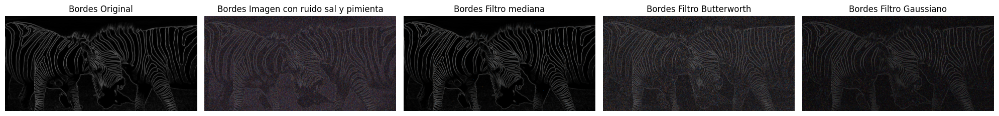

In [ ]:
img3_sob,     img3HP_AfterSmoothing     = extraerBordes(img3)
img3_g_sob,   img3_gHP_AfterSmoothing   = extraerBordes(img3_g)
img3_grm_sob, img3_grmHP_AfterSmoothing = extraerBordes(img3_grm)
img3_grb_sob, img3_grbHP_AfterSmoothing = extraerBordes(img3_grb)
img3_grg_sob, img3_grgHP_AfterSmoothing = extraerBordes(img3_grg)

graficarTodas(img3_sob,'Bordes Original',
              img3_g_sob,'Bordes Imagen con ruido sal y pimienta',
              img3_grm_sob,'Bordes Filtro mediana',
              img3_grb_sob,'Bordes Filtro Butterworth',
              img3_grg_sob,'Bordes Filtro Gaussiano')

Para el ruido de tipo sal y pimienta es posible apreciar como el filtro mediana logra una muy precisa reconstrucción de la imagen, al tratarse de imagenes a blanco y negro con este tipo de ruido, lograndose identificar los bordes de gran manera, al igual que el filtro gaussiano, pero identificandose el suavizado que añade a la salida del filtro.

Finalmente, tenemos el filtro Butterworth, el cual no fue eficiente a la hora de reducir el ruido de sal y pimienta lo que se demuestra a la hora de analizar sus bordes, como se puede apreciar aún mucho ruido en la imagen resultante, obteniendose ruido a lo largo de la imagen aún.

## Conclusiones

- Se pudo observar que los filtros de mediana y Gaussiano tuvieron un desempeño notable en la eliminación del ruido de tipo sal y pimienta, mientras que el filtro Butterworth mostró una mejoría significativa en la atenuación del ruido acústico. Esto sugiere que la elección del filtro adecuado depende en gran medida del tipo de ruido presente en la imagen.

- Al aplicar los filtros para eliminar el ruido, se observó que, en algunos casos, los detalles finos de la imagen original también se vieron afectados. En particular, el filtro de mediana tendió a suavizar más la imagen que los otros filtros, además de modificar los colores, lo que puede resultar en la pérdida de información importante en algunas aplicaciones.

- El filtro de Butterworth demostró una notable capacidad para preservar los bordes de la imagen mientras reducía el ruido. Esto es importante en aplicaciones donde la detección de bordes es crucial, como en procesamiento de imágenes médicas.

- En el caso de imágenes con ruido Acustico, se observó que ningún filtro pudo eliminar completamente este tipo de ruido sin afectar la calidad de la imagen. Esto sugiere que es importante considerar la naturaleza del ruido al seleccionar el método de filtrado más apropiado.

- La elección de los parámetros adecuados para cada filtro es esencial para obtener resultados óptimos. En particular, el tamaño de la ventana de filtro en el caso del filtro de mediana y la frecuencia de corte en el caso del filtro Butterworth deben ajustarse cuidadosamente según las características específicas de la imagen y el ruido.

- Se observó que el filtro de mediana fue el más rápido en términos de procesamiento, seguido por el filtro Gaussiano y el filtro Butterworth. Esto es importante tenerlo en cuenta en aplicaciones en tiempo real o donde la velocidad de procesamiento es un factor crítico.



### Referencias

1. https://en.wikipedia.org/wiki/Total_variation_denoising2
2. Tom Goldstein and Stanley Osher, “The Split Bregman Method For L1 Regularized Problems”, ftp://ftp.math.ucla.edu/pub/camreport/cam08-29.pdf3
3. Pascal Getreuer, “Rudin–Osher–Fatemi Total Variation Denoising using Split Bregman” in Image Processing On Line on 2012–05–19,
4. https://www.ipol.im/pub/art/2012/g-tvd/article_lr.pdf4 https://web.math.ucsb.edu/~cgarcia/UGProjects/BregmanAlgorithms_JacquelineBush.pdf
5. https://scikit-image.org/docs/stable/api/skimage.filters.html